In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

from shapely.geometry import Polygon
from shapely.geometry import Point
from shapely.wkt import loads


In [332]:
df = pd.DataFrame(pd.read_csv("Street_Tree_List-2022-01-30_FILTERED.csv"))

In [355]:
trees = df.copy(deep=True)
trees["PlantDate"] = pd.to_datetime(df["PlantDate"])
trees["PlantDate"][trees["PlantDate"].dt.year >= 2025] -= pd.DateOffset(years=100)

C:\Users\desai\AppData\Local\Temp\ipykernel_35040\3998872196.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  trees["PlantDate"] = pd.to_datetime(df["PlantDate"])
C:\Users\desai\AppData\Local\Temp\ipykernel_35040\3998872196.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  trees["PlantDate"][trees["PlantDate"].dt.year >= 2025] -= pd.DateOffset(years=100)


total entries: 37118, missing entries: 27781


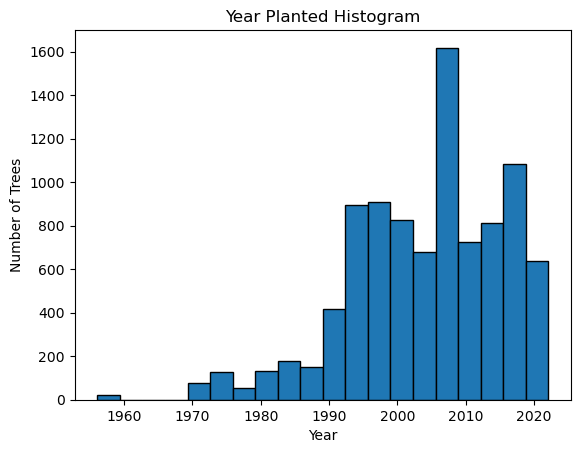

In [356]:
print (f"total entries: {len(trees['PlantDate'])}, missing entries: {trees['PlantDate'].isna().sum()}")
# Plot histogram with custom bins
plt.hist(trees["PlantDate"], bins=20, edgecolor='black')

# Add labels and title
plt.xlabel('Year')
plt.ylabel('Number of Trees')
plt.title('Year Planted Histogram')

# Show the plot
plt.show()

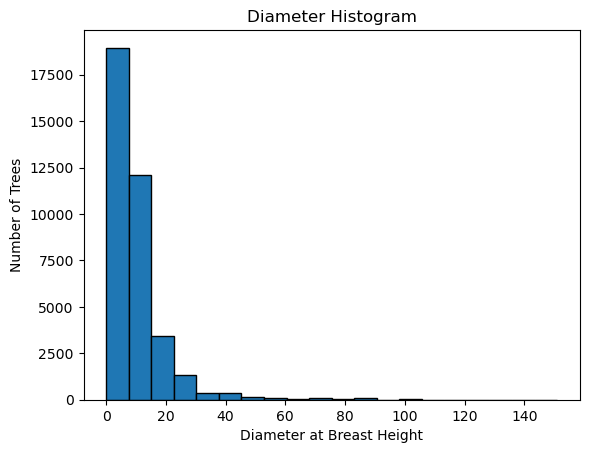

In [357]:
# Plot histogram with custom bins
plt.hist(df['DBH'], bins=20, edgecolor='black')

# Add labels and title
plt.xlabel('Diameter at Breast Height')
plt.ylabel('Number of Trees')
plt.title('Diameter Histogram')

# Show the plot
plt.show()

In [128]:
df = pd.DataFrame(pd.read_csv("2020_CensusTracts_SF.csv", na_values=['(NA)']))
df_reduced = df[['the_geom', 'GEOID', 'NAMELSAD', 'INTPTLAT', 'INTPTLON']]

In [110]:
df_income= pd.DataFrame(pd.read_csv("ACSST5Y2022.S1901-Data.csv"))

#reduce it to key columns
df_income_reduced =df_income[['GEO_ID', 'NAME', 'S1901_C01_012E','S1901_C01_012M', 'S1901_C01_013E', 'S1901_C01_013M']]

#rename and get rid of first row
df_income_reduced = df_income_reduced.rename(columns={"S1901_C01_012E":"est household median income", "S1901_C01_012M":"est household median income margin of error", "S1901_C01_013E":"est household mean income", "S1901_C01_013M":"est household mean income margin of error"}).iloc[1:]

In [112]:
#conversion to numeric
incomes = df_income_reduced.loc[:, ["est household median income", "est household median income margin of error", "est household mean income", "est household mean income margin of error"]].apply(pd.to_numeric, errors='coerce')
ids = df_income_reduced.loc[:, ['GEO_ID', 'NAME']]
df_income_reduced = pd.concat([ids, incomes], axis=1)

#get the census tract part of name
df_income_reduced["NAME"] = df_income_reduced["NAME"].apply(lambda x: x.split(";")[0])

#there are 4 missing values for mean, versus 17 values for median, so I will use mean for analysis
#combine geometry with income data
df_combined = df_reduced.merge(df_income_reduced, left_on="NAMELSAD", right_on="NAME")
df_combined = df_combined.rename(columns={"the_geom":"geometry"})

# Convert WKT strings to Shapely geometries
df_combined['geometry'] = df_combined['geometry'].apply(loads)

# Create a GeoDataFrame
gdf = gpd.GeoDataFrame(df_combined, geometry='geometry', crs="NAD83")

In [363]:
gdf_combined[~gdf_combined["est household mean income"].isna()].explore()

<Axes: title={'center': 'mean household income'}>

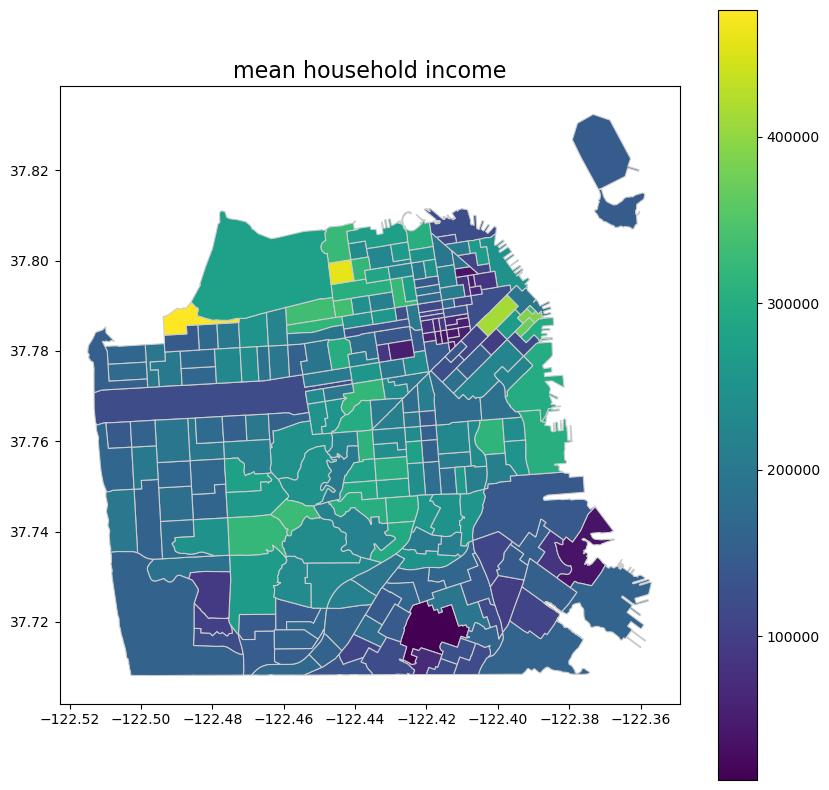

In [361]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))

ax.set_title("mean household income", fontsize=16)

gdf_combined.plot(column="est household mean income", ax=ax, legend=True, cmap='viridis', linewidth=0.8, edgecolor='0.8')

In [182]:
neighborhoods = gpd.read_file("SF-Neighborhoods.geo.json", crs="NAD83").set_crs("NAD83")
neighborhoods= neighborhoods.rename(columns={"name":"neighborhood"})

In [210]:
#make census tract shapes more precise
joined_neighborhoods = neighborhoods["geometry"].buffer(0).unary_union

outlines =[]
for shape in joined_neighborhoods.geoms:
  outlines.append(Polygon(shape.exterior))

gdf_outlines = gpd.GeoDataFrame(geometry=outlines).set_crs("NAD83")

gdf_combined = gpd.overlay(gdf_outlines, gdf, how="intersection")

In [349]:
trees = pd.DataFrame(pd.read_csv("Street_Tree_List-2022-01-30_FILTERED.csv"))
tree_geoms = [Point(lon, lat) for lon, lat in zip(trees['Longitude'], trees['Latitude'])]
gdf_trees = gpd.GeoDataFrame(trees, geometry=tree_geoms, crs="NAD83")

In [350]:
m = gdf_trees.explore()
gdf_combined.explore(m=m, color="pink")

In [458]:
#this is new
gdf_combined = pd.merge(neighborhoods, income_by_census_tract, left_on="neighborhood", right_on="neighborhood").drop(columns="id", index=1)

gdf_joined = gpd.sjoin(gdf_trees, gdf_combined, predicate="within")

In [440]:
gdf_joined.dtypes

TreeID                          int64
qLegalStatus                   object
qSpecies                       object
qAddress                       object
SiteOrder                     float64
qSiteInfo                      object
qCaretaker                     object
PlantDate                      object
DBH                             int64
PlotSize                       object
Latitude                      float64
Longitude                     float64
geometry                     geometry
index_right                     int64
link                           object
neighborhood                   object
est mean household income     float64
dtype: object

In [441]:
tree_counts_by_census_tract = gdf_joined.groupby('NAME').size().reset_index(name='TreeCount')
counties_with_tree_count = pd.merge(gdf_combined, tree_counts_by_census_tract, how='left', left_on='NAME', right_on='NAME')

avgDBH_by_census_tract = gdf_joined.groupby('NAME')["DBH"].median().reset_index(name='AvgDBH')
counties_with_tree_count = pd.merge(counties_with_tree_count, avgDBH_by_census_tract, how='left', left_on='NAME', right_on='NAME')

counties_with_tree_count["area"] = counties_with_tree_count['geometry'].to_crs("EPSG:7131").area
counties_with_tree_count["trees per sqm"] = counties_with_tree_count["TreeCount"] /counties_with_tree_count["area"] 

KeyError: 'NAME'

In [460]:
counties_with_tree_count

,link,neighborhood,geometry,est household mean income,TreeCount,AvgDBH,area,trees per sqm
0,"http://en.wikipedia.org/wiki/Sea_Cliff,_San_Fr...",Seacliff,"POLYGON ((-122.49372 37.78724, -122.49359 37.7...",265635.500000,215.0,7.0,4.608366e+05,4.665428e-04
1,http://www.nps.gov/prsf/index.htm,Presidio National Park,"POLYGON ((-122.47101 37.78724, -122.47101 37.7...",311202.000000,3.0,8.0,6.141207e+06,4.885033e-07
2,NaN,Presidio Terrace,"POLYGON ((-122.47242 37.78734, -122.47101 37.7...",311202.000000,169.0,12.0,3.290579e+05,5.135874e-04
3,http://www.sfgate.com/neighborhoods/sf/innerri...,Inner Richmond,"POLYGON ((-122.47262 37.78632, -122.46683 37.7...",224638.363636,973.0,7.0,2.267821e+06,4.290462e-04
4,NaN,Sutro Heights,"POLYGON ((-122.50309 37.78118, -122.50267 37.7...",162848.000000,155.0,4.0,5.627181e+05,2.754488e-04
...,...,...,...,...,...,...,...,...
111,"http://en.wikipedia.org/wiki/Corona_Heights,_S...",Corona Heights,"POLYGON ((-122.43518 37.76267, -122.43533 37.7...",250013.600000,135.0,12.0,2.845538e+05,4.744270e-04
112,http://en.wikipedia.org/wiki/Haight-Ashbury,Ashbury Heights,"POLYGON ((-122.45210 37.76216, -122.45224 37.7...",229820.000000,242.0,10.0,3.441015e+05,7.032809e-04
113,"http://en.wikipedia.org/wiki/Eureka_Valley,_Sa...",Eureka Valley,"POLYGON ((-122.43734 37.76236, -122.43704 37.7...",259173.222222,506.0,8.0,7.592946e+05,6.664080e-04
114,"http://en.wikipedia.org/wiki/St._Francis_Wood,...",St. Francis Wood,"POLYGON ((-122.47157 37.73470, -122.46831 37.7...",294015.000000,284.0,8.0,4.331585e+05,6.556491e-04


In [465]:
counties_with_tree_count.sort_values(by="trees per sqm", ascending=False).iloc[:5].explore()

In [ ]:
"Census Tract 124.04"

In [391]:
gdf_joined.columns

Index(['TreeID', 'qLegalStatus', 'qSpecies', 'qAddress', 'SiteOrder',
       'qSiteInfo', 'qCaretaker', 'PlantDate', 'DBH', 'PlotSize', 'Latitude',
       'Longitude', 'geometry', 'index_right', 'GEOID', 'NAMELSAD', 'INTPTLAT',
       'INTPTLON', 'GEO_ID', 'NAME', 'est household median income',
       'est household median income margin of error',
       'est household mean income',
       'est household mean income margin of error'],
      dtype='object')

In [396]:
test = gdf_joined.groupby('NAME').get_group("Census Tract 124.04").drop("PlantDate", axis=1)


m = counties_with_tree_count[counties_with_tree_count["NAME"] == "Census Tract 124.04"].explore()
test.explore(m=m, color="pink")

tree_12404 = gdf_joined.groupby('NAME').get_group("Census Tract 133").drop("PlantDate", axis=1)
tract_12404 = counties_with_tree_count[counties_with_tree_count["NAME"] == "Census Tract 133"]
m = tract_12404 .explore()
tree_12404.explore(m=m, color="pink")

In [463]:
counties_with_tree_count.sort_values(by="est household mean income", ascending=False).iloc[:10].explore()

<Axes: >

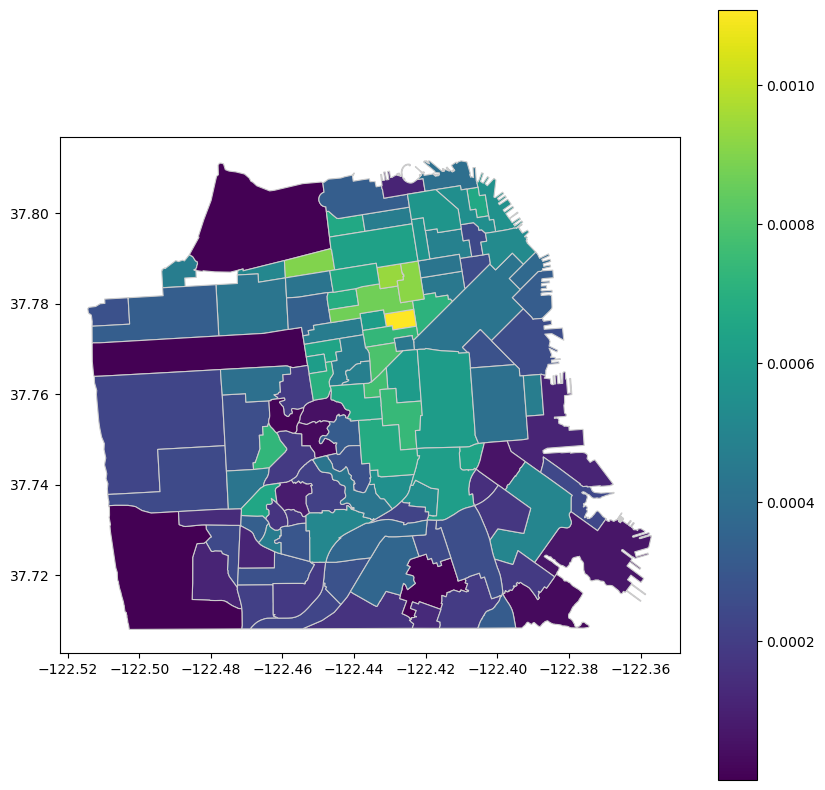

In [466]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
counties_with_tree_count.plot(column="trees per sqm", ax=ax, legend=True, cmap='viridis', linewidth=0.8, edgecolor='0.8')

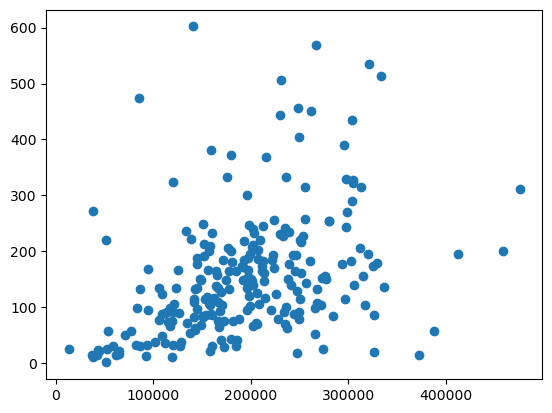

In [291]:
plt.scatter(counties_with_tree_count["est household mean income"], counties_with_tree_count["TreeCount"])

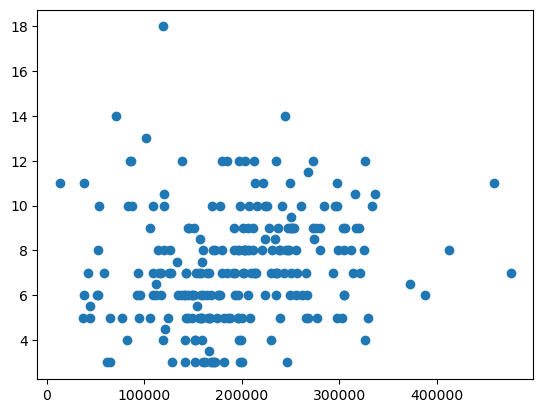

In [329]:
plt.scatter(counties_with_tree_count["est household mean income"], counties_with_tree_count["AvgDBH"])

In [464]:
test =counties_with_tree_count[["est household mean income",  "AvgDBH", "trees per sqm", "TreeCount"]]
test.corr()

,est household mean income,AvgDBH,trees per sqm,TreeCount
est household mean income,1.000000,0.137441,0.205266,0.037535
AvgDBH,0.137441,1.000000,0.248874,-0.161369
trees per sqm,0.205266,0.248874,1.000000,0.357522
TreeCount,0.037535,-0.161369,0.357522,1.000000


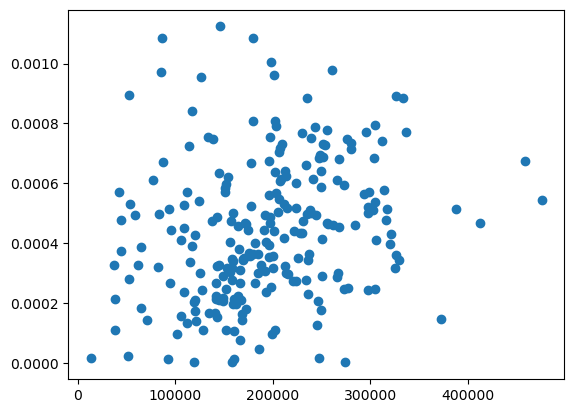

In [277]:
plt.scatter(counties_with_tree_count["est household mean income"], counties_with_tree_count["trees per sqm"])

In [255]:
n = "Census Tract 211"

m = gdf_joined[gdf_joined["NAME"]== n].explore()
gdf_combined[gdf_combined["NAME"]== n].explore(m=m, color="pink")